<font size="+3">Tile toolkit</font>

The tiletoolkit is used to plot raster from a raster server.  

Imports 

In [1]:
from hera import toolkitHome
import matplotlib.pyplot as plt

In [2]:
projectName = "DOCUMENTATION"
tk = toolkitHome.getToolkit(toolkitHome.GIS_TILES,projectName=projectName)

When using the toolkit we can use the default server or a specified server.  
For checking the default server, use the following command:

In [3]:
tk.getConfig()['defaultTileServer']

'http://mt1.google.com/vt/lyrs=s&x={x}&y={y}&z={z}'

The default server is Google maps.

When ploting a region, we specify the region points coordinates (down left and upper right) using minx,miny,maxx,maxy.  
The default input coordinates are WSG84.  
We can get the image using the **getImageFromCorners()** by passing the dictionary of the region using the following example:

In [5]:
minx = 34.775
maxx = 34.8
maxy = 32.1
miny = 32.05

region = dict(minx=minx,maxx=maxx,maxy=maxy,miny=miny,zoomlevel=17,tileServer=None)
img = tk.getImageFromCorners(**region)

For using a default tile server, we specify the tileServer=**None**, as seen above.  

Note that IMS coordinates can also be used.  
We specify the inputCRS argument as ITM:

In [6]:
from hera.measurements.GIS.utils import WSG84,ITM,convertCRS

minx = 178898.481
maxx = 181280.365
maxy = 667478.9
miny = 661943.482

region = dict(minx=minx,maxx=maxx,maxy=maxy,miny=miny,zoomlevel=17,tileServer=None,inputCRS=ITM)
img = tk.getImageFromCorners(**region)

We can plot the image using the presentation layer of the toolkit. We do this with the **plot()** function. One can also control the output coordinates (WSG84 or ITM) using the outputCRS argument (default is ITM):

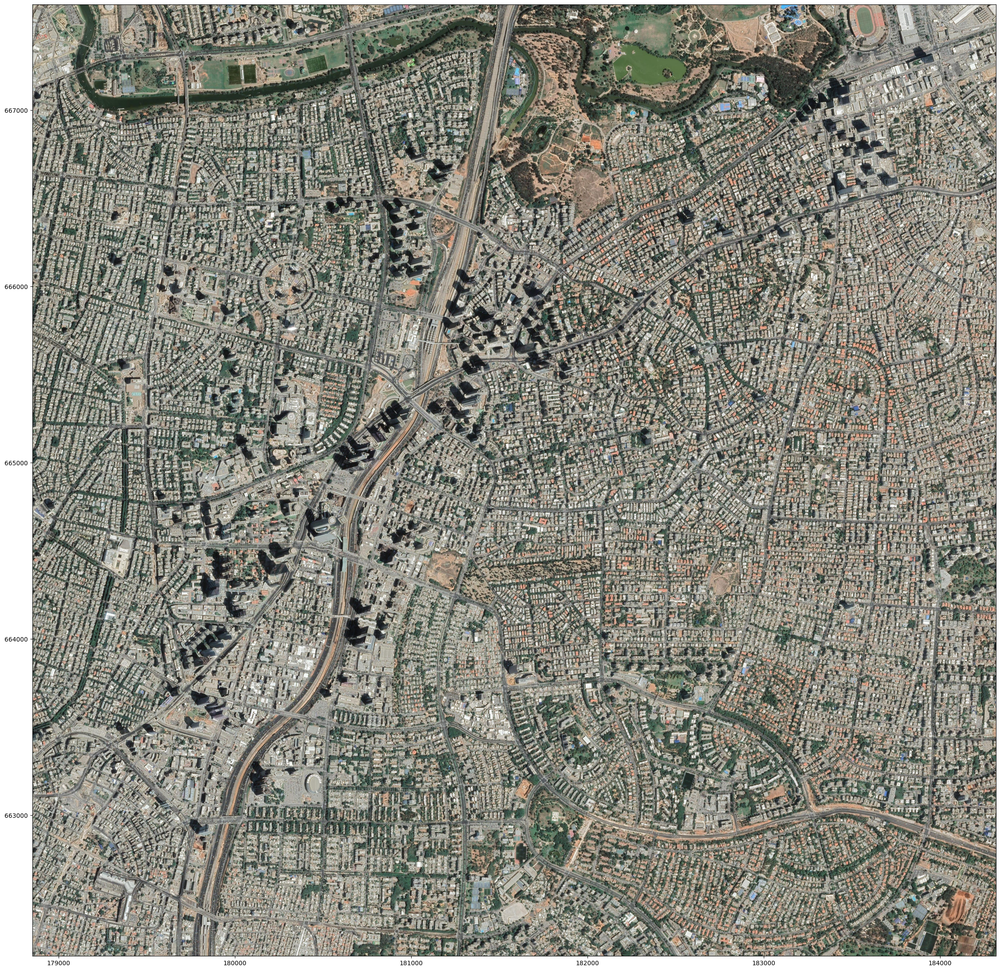

In [7]:
fig,ax = plt.subplots(1,1,figsize=(28,28))
tk.presentation.plot(img,ax=ax)

Output with WSG64 coordinates:

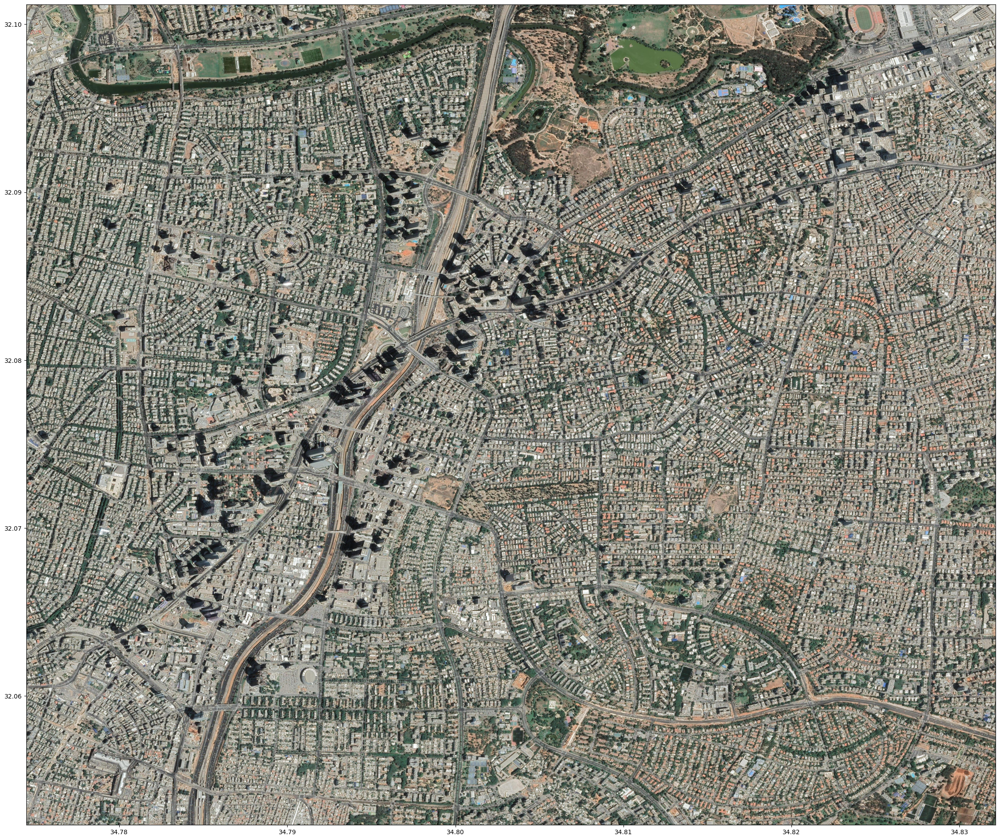

In [8]:
fig,ax = plt.subplots(1,1,figsize=(28,28))
tk.presentation.plot(img,outputCRS=WSG84,ax=ax)

For setting a new default server:

In [9]:
tk.setDefaultTileServer("OTHER_API")

In [10]:
tk.getConfig()

{'analysis_CacheCounter': 13,
 'defaultBuildingDataSource': 'BNTL',
 'defaultSRTM': 'SRTMGL1',
 'defaultLandCover': 'Type-1',
 'defaultTileServer': 'OTHER_API'}